# Siamese Networks and VAE
In this notebook, the goal is to derive and visualize the features of each photo or class derived from the deep learning models. We are going to apply Siamese networks and Variational Autoencoders to the dataset. Both of the models somehow map each datapoint to $z$ dimentional real space, representing its features.

Siamese networks train a convolutional model that tries to find features for the datapoints in which the features of datapoints of a certain class, have small pairwise distance in our space. This constraint on the features comes from the contrastive loss function. On the other hand Variational Autoencoder trains two networks simmultanusly, an encoder and a decoder. the encoder has the same architecture as the convolutional model in the Siamese networks. The mappings of Variational Autoencoder from each datapoint to a $z$ dimentional vector is also a good representation of the data in order to have the ability to generate the data from it. Variational Autoencoders are strong in multiclass generation with large number of classes. 

First we Initialize and define the data generator, then we create and train Siamese networks, and in the last part we analyse Autoencoders.

## Import and initializing

In [1]:
import os
import random
import itertools
from tqdm import tqdm
import time
import random


import tensorflow as tf

import logging
tf.get_logger().setLevel(logging.ERROR)
# If you have a GPU, execute the following lines to restrict the amount of VRAM used:
gpus = tf.config.experimental.list_physical_devices('GPU')
if len(gpus) > 0:
    print("Using GPU {}".format(gpus[0]))
    tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
else:
    print("Using CPU")

from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input, Concatenate, Lambda, Dot
dot = Dot(axes=-1, normalize=True)
from tensorflow.keras.layers import Conv2D, MaxPool2D, GlobalAveragePooling2D, Flatten, Dropout
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
%matplotlib inline

Using GPU PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


## Define Tensorflow Data Generator Class

In [2]:
class Generator(tf.keras.utils.Sequence):

    def __init__(self, path, batch_size, num_classes = None, mode="train", sample_per_class = 100):
        
        self.PATH = path
        self.dirs = os.listdir(self.PATH)
        if num_classes:
            self.dirs = self.dirs[144:(144+num_classes)]

        self.name_to_classid = {d: i for i, d in enumerate(self.dirs)}
        self.classid_to_name = {v: k for k, v in self.name_to_classid.items()}
        
        self.num_classes = len(self.name_to_classid)        
        self.batch_size = batch_size
        self.sample_per_class = sample_per_class
        
        self.all_images_path, self.path_to_id, self.id_to_path, self.classid_to_ids, self.id_to_classid = self.build_df()
        
        self.X1, self.X2, self.Y = self.build_train_test_data(mode)
        
        self.Y_id = self.Y[...,0]
        self.Y_c1 = self.Y[...,1]
        self.Y_c2 = self.Y[...,2]
        
        self.num_samples = self.Y.shape[0]
        
    def build_df(self):
        # read all directories
        img_paths = {c: [self.PATH + subfolder + "/" + img
                         for img in sorted(os.listdir(self.PATH + subfolder))] 
                     for subfolder, c in self.name_to_classid.items()}

        # retrieve all images
        all_images_path = []
        for img_list in img_paths.values():
            all_images_path += img_list

        # map to integers
        path_to_id = {v: k for k, v in enumerate(all_images_path)}
        id_to_path = {v: k for k, v in path_to_id.items()}
        
        # build mappings between images and class
        classid_to_ids = {}
        for x in img_paths:
            for y in img_paths[x]:
                pid = path_to_id[y]
                if x in classid_to_ids.keys():
                    classid_to_ids[x].append(pid)
                else:
                    classid_to_ids[x] = [pid]

        id_to_classid = {v: c for c, imgs in classid_to_ids.items() for v in imgs}
        
        return all_images_path, path_to_id, id_to_path, classid_to_ids, id_to_classid
        
    # build pairs of positive image ids for a given classid
    def build_pos_pairs_for_id(self, classid, max_num=100):
        imgs = self.classid_to_ids[classid]

        if len(imgs) == 1:
            return []

        pos_pairs = list(itertools.combinations(imgs, 2))

        random.shuffle(pos_pairs)
        return pos_pairs[:max_num]
    
    # build pairs of negative image ids for a given classid
    def build_neg_pairs_for_id(self, classid, classes, max_num=100):
        imgs = self.classid_to_ids[classid]
        neg_classes_ids = [random.choice(classes) for _ in range(max_num)]
        neg_classes_ids = [x for x in neg_classes_ids if x != classid]
        assert classid not in neg_classes_ids
        neg_pairs = []
        neg_classes = []
        for id2 in range(len(neg_classes_ids)):
            img1 = imgs[random.randint(0, len(imgs) - 1)]
            imgs2 = self.classid_to_ids[neg_classes_ids[id2]]
            img2 = imgs2[random.randint(0, len(imgs2) - 1)]
            neg_pairs += [(img1, img2)]
            neg_classes += [neg_classes_ids[id2]]
        return neg_pairs, neg_classes
    
    def build_train_test_data(self, mode="train", split=0.8):
        listX1 = []
        listX2 = []
        listY = []
        split = int(self.num_classes * split)

        if mode == "train": # train
            for class_id in tqdm(range(split)):
                pos = self.build_pos_pairs_for_id(class_id, self.sample_per_class)
                neg, neg_classes = self.build_neg_pairs_for_id(class_id, list(range(split)), self.sample_per_class)
                for pair in pos:
                    listX1 += [pair[0]]
                    listX2 += [pair[1]]
                    listY += [[1, class_id, class_id]]
                for itr, pair in enumerate(neg):
                    if sum([x[0] for x in listY]) > len(listY) / 2:
                        listX1 += [pair[0]]
                        listX2 += [pair[1]]
                        listY += [[0, class_id, neg_classes[itr]]]

            perm = np.random.permutation(len(listX1))
            X1_ids = np.array(listX1)[perm]
            X2_ids = np.array(listX2)[perm]
            Y_ids = np.array(listY)[perm]

        if mode == "test":
        #test
            for class_id in tqdm(range(split, self.num_classes)):
                pos = self.build_pos_pairs_for_id(class_id, self.sample_per_class)
                neg, neg_classes = self.build_neg_pairs_for_id(class_id, list(range(split, self.num_classes)), self.sample_per_class)
                for pair in pos:
                    listX1 += [pair[0]]
                    listX2 += [pair[1]]
                    listY += [[1, class_id, class_id]]
                for itr, pair in enumerate(neg):
                    if sum([x[0] for x in listY]) > len(listY) / 2:
                        listX1 += [pair[0]]
                        listX2 += [pair[1]]
                        listY += [[0, class_id, neg_classes[itr]]]
            perm = np.random.permutation(len(listX1))
            X1_ids = np.array(listX1)[perm]
            X2_ids = np.array(listX2)[perm]
            Y_ids = np.array(listY)[perm]
            
            
        return (X1_ids, X2_ids, Y_ids)
    
    def imgs(self, idx):
        image = [tf.keras.preprocessing.image.load_img(self.id_to_path[x]) for x in idx]
        image_arr = [tf.keras.preprocessing.image.img_to_array(x) for x in image]
        image_arr = [tf.image.resize(x,(256, 256)).numpy()/255 for x in image_arr]
        return image_arr
    
    def __len__(self):
        return self.num_samples // self.batch_size
    
    def __getitem__(self, batch_index):
        """This method returns the `batch_index`-th batch of the dataset.
        
        Keras choose by itself the order in which batches are created, and several may be created
        in the same time using multiprocessing. Therefore, avoid any side-effect in this method!
        """
        low_index = batch_index * self.batch_size
        high_index = (batch_index + 1) * self.batch_size
        
        imgs1 = self.imgs(self.X1[low_index:high_index])
        imgs2 = self.imgs(self.X2[low_index:high_index])
        targets = self.Y_id[low_index:high_index]
        cl1s = self.Y_c1[low_index:high_index]
        cl2s = self.Y_c2[low_index:high_index]
        cl1s = np.asarray([np.eye(self.num_classes)[x] for x in cl1s])
        cl2s = np.asarray([np.eye(self.num_classes)[x] for x in cl2s])
        return ([np.asarray(imgs1), np.asarray(imgs2)], targets)

## Create Generators for the Training and Testing data
Don't load all data specially if you don't want to start a training, because it could take time. For the training we have used 3000 classes of the data (each containing around 600 images). you can change 3000 to 10 in the code below to skip this step. 

In [3]:
batch_size = 32
gen = Generator("CASIA-HWDB_Train/Train/", batch_size, 3000, "train", 100)
gen_t = Generator("CASIA-HWDB_Train/Train/", batch_size, 3000, "test", 100)
import pickle 
object_pi = [gen, gen_t] 
file_pi = open('generators.pkl', 'wb') 
pickle.dump(object_pi, file_pi)

100%|██████████| 600/600 [03:34<00:00,  2.80it/s]


CASIA-HWDB_Train/Train/цИО/1.png


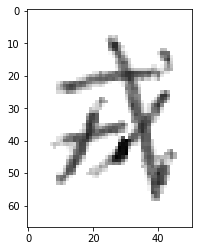

In [6]:
print(gen.id_to_path[gen.classid_to_ids[0][0]])
ss = plt.imshow(plt.imread(gen.id_to_path[gen.classid_to_ids[0][2]])), plt.show()

# Siamese Networks
In this section we will build and train a Siamese model. First we create the loss and accuracy functions and then we define the Convolutional Block and consecutively the siamese model, then we will train the model.

## Defining Loss and Accuracy Functions

In [4]:
@tf.function
def contrastive_loss(y_true, y_pred, margin=0.25):
    '''Contrastive loss from Hadsell-et-al.'06
    http://yann.lecun.com/exdb/publis/pdf/hadsell-chopra-lecun-06.pdf
    '''
    y_true = tf.cast(y_true, "float32")
    return tf.reduce_mean( y_true * tf.square(1 - y_pred) +
                  (1 - y_true) * tf.square(tf.maximum(y_pred - margin, 0)))

In [5]:
@tf.function
def accuracy_sim(y_true, y_pred, threshold=0.5):
    '''Compute classification accuracy with a fixed threshold on similarity.
    '''
    y_thresholded = tf.cast(y_pred > threshold, "float32")
    return tf.reduce_mean(tf.cast(tf.equal(y_true, y_thresholded), "float32"))

## Defining Convolutional Block

In [6]:
def SharedConv(num_features = 50):

    conv1 = Conv2D(16, 3, activation="relu", padding="same", name = "conv1")
    conv2 = Conv2D(16, 3, activation="relu", padding="same", name = "conv2")
    pool1 = MaxPool2D((2,2)) # 30,30
    conv3 = Conv2D(32, 3, activation="relu", padding="same", name = "conv3")
    conv4 = Conv2D(32, 3, activation="relu", padding="same", name = "conv4")
    pool2 = MaxPool2D((2,2)) # 15,15
    conv5 = Conv2D(64, 3, activation="relu", padding="same", name = "conv5")
    conv6 = Conv2D(64, 3, activation="relu", padding="same", name = "conv6")
    pool3 = MaxPool2D((2,2)) # 8,8
    conv7 = Conv2D(64, 3, activation="relu", padding="same", name = "conv7")
    conv8 = Conv2D(32, 3, activation="relu", padding="same", name = "conv8")
    flatten = Flatten()
    dropout = Dropout(0.2)
    fc = Dense(num_features)
    
    inputs = tf.keras.Input(shape=(256,256,3))
    x = tf.expand_dims(tf.reduce_mean(inputs, -1), -1)
    x = pool1(conv2(conv1(x)))
    x = pool2(conv4(conv3(x)))
    x = pool3(conv6(conv5(x)))
    x = flatten(conv8(conv7(x)))

    x = fc(dropout(x))
    model = tf.keras.Model(inputs, x)
    return model


## Defining Siamese Model

In [7]:
cross_entropy = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
def Siamese(sharedconv, num_classes):
    dot = Dot(axes=-1, normalize=True)
    i1 = tf.keras.Input(shape=(256,256,3))
    i2 = tf.keras.Input(shape=(256,256,3))
    x1 = sharedconv(i1)
    x2 = sharedconv(i2)
#     o1 = dense(x1)
#     o2 = dense(x2)
#     model = tf.keras.Model([i1,i2], [dot([x1, x2]), o1, o2])
    model = tf.keras.Model([i1,i2], dot([x1, x2]))
    return model

sharedconv = SharedConv()
siamese_model = Siamese(sharedconv, 160)
# model.compile(loss=[contrastive_loss, cross_entropy, cross_entropy], loss_weights=[1,0.2,0.2], optimizer='rmsprop', metrics=[accuracy_sim, accuracy_sim2])
siamese_model.compile(loss=contrastive_loss, optimizer='rmsprop', metrics=[accuracy_sim])
siamese_model.build([None, 256, 256, 3])

## Let's see the model's summary

In [8]:
print("Siamese Network:")
siamese_model.summary()

Siamese Network:
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 50)           1765634     input_2[0][0]                    
                                                                 input_3[0][0]                    
__________________________________________________________________________________________________
dot (Dot)                       (None, 1)            0           model[1][0

## Training the model
If you want to skip training and load the trained model, uncomment the 4th line and comment the 5th line

In [9]:
best_model_fname = "siamese_checkpoint_last.h5"
siamese_model.load_weights("siamese_checkpoint_last.h5")
best_model_cb = ModelCheckpoint(best_model_fname, monitor='val_accuracy_sim', save_best_only=True, verbose=1)
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
siamese_model.fit(gen, 
        epochs=5,
        validation_data=gen_t,
        callbacks=[best_model_cb], verbose=1)
# siamese_model.save(best_model_fname)

Epoch 1/5
146/146 [==============================] - ETA: 0s - loss: 0.0295 - accuracy_sim: 0.9257
Epoch 00001: val_accuracy_sim improved from -inf to 0.94301, saving model to siamese_checkpoint_last.h5
146/146 [==============================] - 35s 238ms/step - loss: 0.0295 - accuracy_sim: 0.9257 - val_loss: 0.0400 - val_accuracy_sim: 0.9430
Epoch 2/5
146/146 [==============================] - ETA: 0s - loss: 0.0234 - accuracy_sim: 0.9443
Epoch 00002: val_accuracy_sim improved from 0.94301 to 0.94945, saving model to siamese_checkpoint_last.h5
146/146 [==============================] - 36s 245ms/step - loss: 0.0234 - accuracy_sim: 0.9443 - val_loss: 0.0502 - val_accuracy_sim: 0.9494
Epoch 3/5
146/146 [==============================] - ETA: 0s - loss: 0.0199 - accuracy_sim: 0.9587
Epoch 00003: val_accuracy_sim did not improve from 0.94945
146/146 [==============================] - 37s 250ms/step - loss: 0.0199 - accuracy_sim: 0.9587 - val_loss: 0.0453 - val_accuracy_sim: 0.9467
Epoch 4

## Let's see some wrong predictions

In this batch, we have 0 wrong predictions
skipping batch
In this batch, we have 0 wrong predictions
skipping batch
In this batch, we have 3 wrong predictions
True labels:  [0, 0, 0]


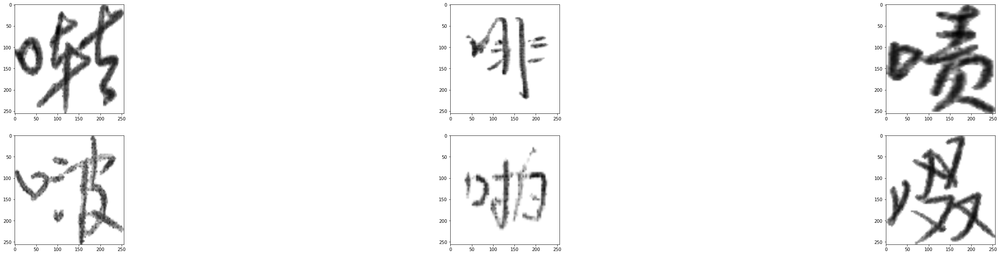

In this batch, we have 0 wrong predictions
skipping batch
In this batch, we have 1 wrong predictions
True labels:  [0]


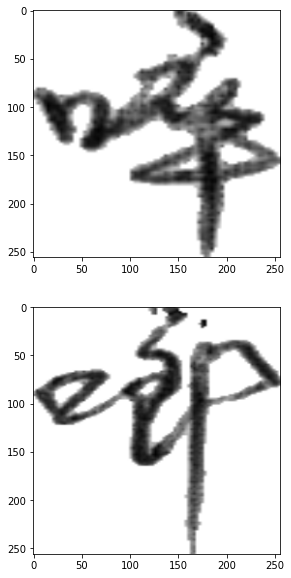

In this batch, we have 1 wrong predictions
True labels:  [0]


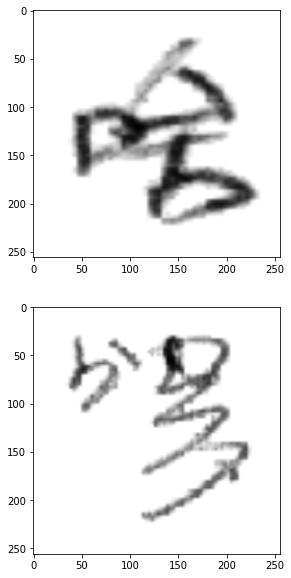

In this batch, we have 1 wrong predictions
True labels:  [0]


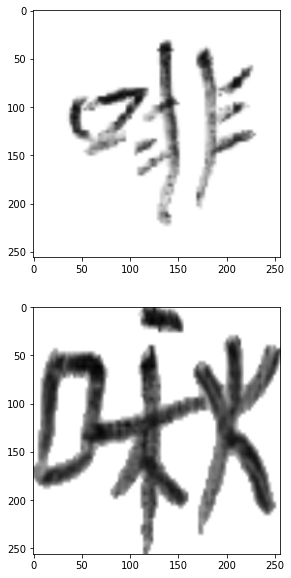

In this batch, we have 1 wrong predictions
True labels:  [0]


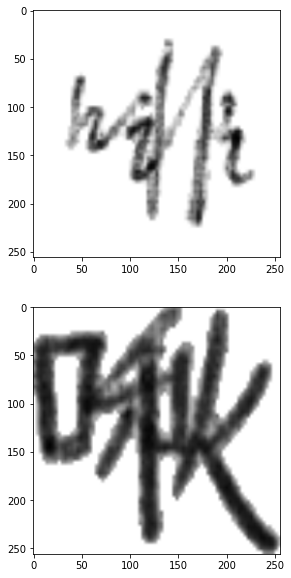

In this batch, we have 0 wrong predictions
skipping batch
In this batch, we have 2 wrong predictions
True labels:  [0, 0]


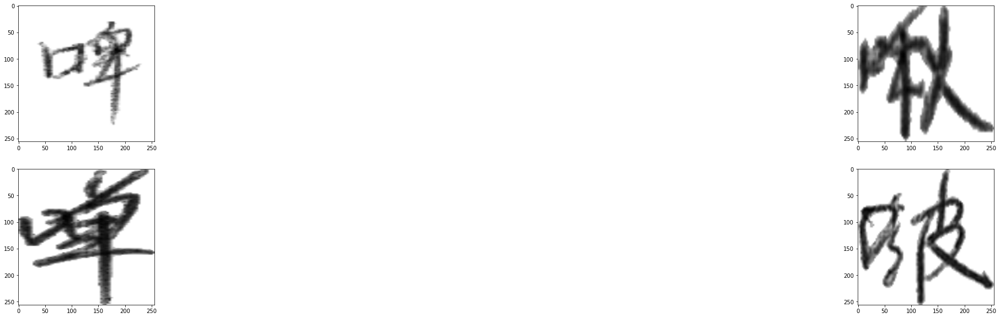

In this batch, we have 0 wrong predictions
skipping batch
In this batch, we have 1 wrong predictions
True labels:  [0]


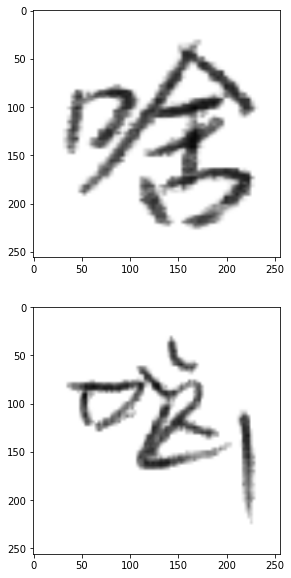

In [12]:
limit = 10
ctr = 0
for itr, (test_x, test_y) in enumerate(gen):
    y_pred = siamese_model(test_x*255)
    y_pred = [x[0] for x in y_pred.numpy()]
    
    predss = [int(x>0.5) for x in y_pred] 
    targtess = [int(x) for x in test_y]
    wrongs = [int(x!=y) for x,y in zip(predss, targtess)]
    print(f"In this batch, we have {sum(wrongs)} wrong predictions")
    if sum(wrongs) == 0:
        continue
    ctr += 1
    wrong_idxs = [i for i,val in enumerate(wrongs) if val==1]
    print("True labels: ", [test_y[x] for x in wrong_idxs])
    fig, ax = plt.subplots(2, len(wrong_idxs), figsize=(50, 10))
    for it, idx in enumerate(wrong_idxs):
        if sum(wrongs) > 1:
            ax[0, it].imshow(test_x[0][idx])
            ax[1, it].imshow(test_x[1][idx])
        else:
            ax[0].imshow(test_x[0][idx])
            ax[1].imshow(test_x[1][idx])
    plt.show()
        
    if itr > limit:
        break

## Visualizing Convolutional Features
In this section, we are going to visualize the hidden layers of the convolutional model used in the Siamese network. First, lets see a summary of the convolutional model:

In [12]:
print("Shared Network:")
sharedconv.summary()

Shared Network:
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
tf_op_layer_Mean (TensorFlow multiple                  0         
_________________________________________________________________
tf_op_layer_ExpandDims (Tens multiple                  0         
_________________________________________________________________
conv1 (Conv2D)               (None, 256, 256, 16)      160       
_________________________________________________________________
conv2 (Conv2D)               (None, 256, 256, 16)      2320      
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 16)      0         
_________________________________________________________________
conv3 (Conv2D)               (None, 128, 128,

## Visualizing
we have used `mini_lucid_tf2` in order to optimize the input image to activate the channels of a specefic layer in the network, for example for the layer `max_pooling2d_2` above we can run this algorithm.

This algorithm fixes an objective function, and tries to optimize the input image of a convolutional model in order to maximizes the objective function. For the mentioned layer, we have 64 channels. Each row in the diagram below, is the results of fixing a few number of the channels, and maximizing 5 random linear combination of them (that's why they are similar but slightly different). 

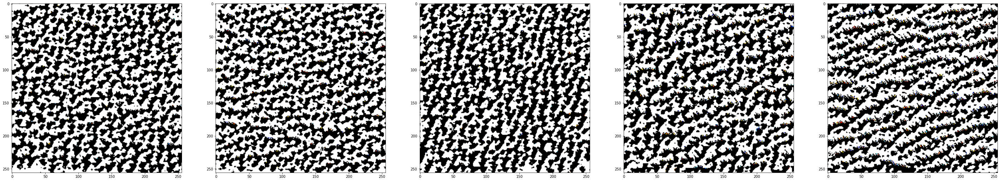

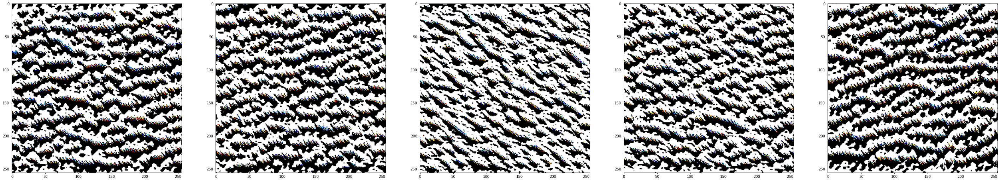

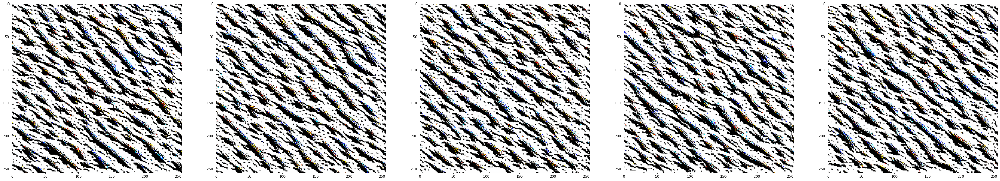

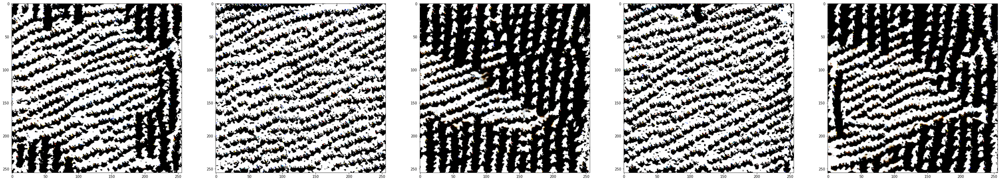

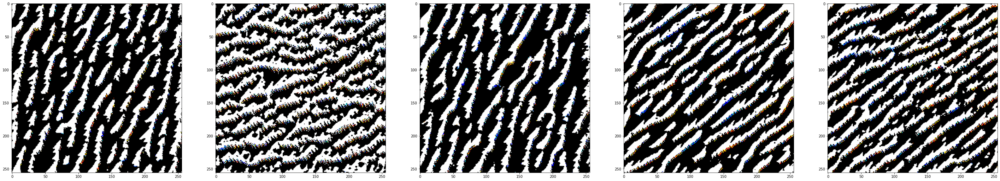

In [27]:
from mini_lucid_tf2 import objectives, render
layer_name = 'max_pooling2d_2'
layer_size = 64
sd_coef = 5

num_rel_interp = 5
num_dif_samples = 5

for j in range(num_dif_samples):
    chosen_indexes = random.sample(range(layer_size), 5)
    fig, ax = plt.subplots(1, num_rel_interp, figsize=(50, 50))
    for itr in range(num_rel_interp):
        rel_imp = [np.exp((random.random()-0.5)*sd_coef) for _ in range(layer_size)]
        obj = objectives.Channel(sharedconv, layer_name, chosen_indexes[0])*rel_imp[chosen_indexes[0]] 
        for i in chosen_indexes[1:]:
            obj += objectives.Channel(sharedconv, layer_name, i)*rel_imp[i]
        image = render.render_vis(obj, 256)
        ax[itr].imshow(image[0])
    plt.show()

In [6]:
batch_size = 32
def encoder(latent_dim = 50):
    encoder = tf.keras.Sequential([
        tf.keras.layers.InputLayer(input_shape=(256, 256, 3), batch_size=batch_size),
        tf.keras.layers.Conv2D(
            filters=32, kernel_size=3, strides=(2, 2), activation='relu'),
        tf.keras.layers.Conv2D(
            filters=64, kernel_size=3, strides=(2, 2), activation='relu'),
        tf.keras.layers.Conv2D(
            filters=128, kernel_size=3, strides=(2, 2), activation='relu'),
        tf.keras.layers.Conv2D(
            filters=256, kernel_size=3, strides=(2, 2), activation='relu'),
        tf.keras.layers.Conv2D(
            filters=256, kernel_size=3, strides=(2, 2), activation='relu'),
        tf.keras.layers.Flatten(),
        # No activation
        tf.keras.layers.Dense(latent_dim + latent_dim)])
    return encoder

def decoder(latent_dim = 50):
    decoder = tf.keras.Sequential([
        tf.keras.layers.InputLayer(input_shape=(latent_dim), batch_size=batch_size),
        tf.keras.layers.Dense(units=8*8*32, activation=tf.nn.relu),
        tf.keras.layers.Reshape(target_shape=(8, 8, 32)),
        tf.keras.layers.Conv2DTranspose(
            filters=256, kernel_size=3, strides=2, padding='same',
            activation='relu'),
        tf.keras.layers.Conv2DTranspose(
            filters=128, kernel_size=3, strides=2, padding='same',
            activation='relu'),
        tf.keras.layers.Conv2DTranspose(
            filters=64, kernel_size=3, strides=2, padding='same',
            activation='relu'),
        tf.keras.layers.Conv2DTranspose(
            filters=32, kernel_size=3, strides=2, padding='same',
            activation='relu'),
        tf.keras.layers.Conv2DTranspose(
            filters=32, kernel_size=3, strides=2, padding='same',
            activation='relu'),
        # No activation
        tf.keras.layers.Conv2DTranspose(
            filters=3, kernel_size=3, strides=1, padding='same')])
    
    return decoder



In [7]:
def VAE_model(conv_part, deconv_part):
    inputs = tf.keras.Input(shape=(256,256,3), batch_size=batch_size)
    mean, logvar = tf.split(conv_part(inputs), num_or_size_splits=2, axis=1)
    
    eps = tf.random.normal(shape=mean.shape)
    z = eps * tf.exp(logvar * .5) + mean
#     z = reparameterize(mean, logvar)
    x_logit = deconv_part(z)


    model = tf.keras.Model(inputs, [x_logit, z, mean, logvar])
    model.build([None, 256, 256, 3])
    return model

def VAE_Siamese_model(conv_part, deconv_part):
    dot = Dot(axes=-1, normalize=True)
    inputs1 = tf.keras.Input(shape=(256,256,3), batch_size=batch_size)
    inputs2 = tf.keras.Input(shape=(256,256,3), batch_size=batch_size)
    mean1, logvar1 = tf.split(conv_part(inputs1), num_or_size_splits=2, axis=1)
    mean2, logvar2 = tf.split(conv_part(inputs2), num_or_size_splits=2, axis=1)
    
    eps1 = tf.random.normal(shape=mean1.shape)
    z1 = eps1 * tf.exp(logvar1 * .5) + mean1
    eps2 = tf.random.normal(shape=mean2.shape)
    z2 = eps2 * tf.exp(logvar2 * .5) + mean2

    x_logit1 = deconv_part(z1)
    x_logit2 = deconv_part(z2)
    
    zdots = dot([z1, z2])
    model = tf.keras.Model([inputs1, inputs2], [x_logit1, z1, mean1, logvar1, x_logit2, z2, mean2, logvar2, zdots])
    model.build([None, 256, 256, 3])
    return model

#     dot = Dot(axes=-1, normalize=True)
#     dense = Dense(num_classes)
#     i1 = tf.keras.Input(shape=(32,32,1))
#     i2 = tf.keras.Input(shape=(256,256,3))
#     x_logits, z = sharedvae(i1)
#     x2 = sharedconv(i2)
#     o1 = dense(x1)
#     o2 = dense(x2)
#     model = tf.keras.Model([i1,i2], [dot([x1, x2]), o1, o2])
#     model = tf.keras.Model(i1, [x_logits, z])
#     return model


In [8]:
def log_normal_pdf(sample, mean, logvar, raxis=1):
    log2pi = tf.math.log(2. * np.pi)
    return tf.reduce_sum(
      -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
      axis=raxis)

def elbo_loss(inputs):
    def loss(y_true, y_pred):
        pr_x, pr_z, pr_m, pr_l = y_pred
        cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=pr_x, labels=inputs)
        logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3])

        logpz = log_normal_pdf(pr_z, 0., 0.)
        logqz_x = log_normal_pdf(pr_z, pr_m, pr_l)

        return -tf.reduce_mean(logpx_z + logpz - logqz_x)
    return loss

In [12]:
latent_dim = 50
conv_part = encoder(latent_dim)
deconv_part = decoder(latent_dim)
model = VAE_model(conv_part, deconv_part)
model.load_weights("vae_checkpoint_last.h5")
optimizer = tf.keras.optimizers.Adam(1e-4)   

In [14]:
epochs = 10
for epoch in range(1, epochs + 1):
    losss = []
    start_time = time.time()
    pbar = tqdm(gen)
    for train_x, train_y in pbar:
        tx1, tx2 = train_x
        with tf.GradientTape() as tape:
            loss = elbo_loss(tx1)(None, model(tx1))
            loss2 = elbo_loss(tx2)(None, model(tx2))
            losss.append(loss.numpy())
            losss.append(loss2.numpy())
            gradients = tape.gradient([loss, loss2], model.trainable_variables)
            optimizer.apply_gradients(zip(gradients, model.trainable_variables))
        pbar.set_postfix({'ELBO': np.mean(losss)})
#         train_step(model, tx1, optimizer)
    end_time = time.time()

    losss = []
    for test_x, test_y in tqdm(gen_t):
        tx1, tx2 = test_x
        loss = elbo_loss(tx1)(None, model(tx1))
        loss2 = elbo_loss(tx2)(None, model(tx2))
        losss.append(loss.numpy())
        losss.append(loss2.numpy())
        
    elbo = np.mean(losss)
    print('Epoch: {}, Test set ELBO: {}, time elapse for current epoch: {}'
        .format(epoch, elbo, end_time - start_time))
    model.save("vae_checkpoint_last.h5")

  0%|          | 0/14996 [00:00<?, ?it/s]

Epoch: 1, Test set ELBO: 47418.80859375, time elapse for current epoch: 9013.49068069458


  0%|          | 55/14996 [00:32<2:26:24,  1.70it/s, ELBO=4.57e+4]


KeyboardInterrupt: 

In [9]:
latent_dim = 50
conv_part2 = encoder(latent_dim)
deconv_part2 = decoder(latent_dim)
model_vae_siamese = VAE_Siamese_model(conv_part2, deconv_part2)
model_vae_siamese.load_weights("vae_siamese_checkpoint_last.h5")
optimizer = tf.keras.optimizers.Adam(1e-4)   
epochs = 20

In [49]:
for epoch in range(1, epochs + 1):
    losss = []
    elbos = []
    accs = []
    start_time = time.time()
    pbar = tqdm(gen)
    for train_x, train_y in pbar:
        tx1, tx2 = train_x
        with tf.GradientTape() as tape:
            x_logit1, z1, mean1, logvar1, x_logit2, z2, mean2, logvar2, zdots = model_vae_siamese([tx1, tx2])
            loss1 = elbo_loss(tx1)(None, [x_logit1, z1, mean1, logvar1])
            loss2 = elbo_loss(tx2)(None, [x_logit2, z2, mean2, logvar2])
            loss_cts = contrastive_loss(train_y, zdots)
            losss.append((loss1.numpy() + loss2.numpy() + loss_cts.numpy()))
            elbos.append(loss1.numpy())
            elbos.append(loss2.numpy())
#             print(z1.shape, z2.shape)
            predss = [int(x>0.5) for x in dot([z1, z2]).numpy()] 
            targtess = [int(x) for x in train_y]
            wrongs = [int(x!=y) for x,y in zip(predss, targtess)]
    #         acc = accuracy_sim(test_y, ).numpy()
            accs.append((batch_size - sum(wrongs))/batch_size)
            gradients = tape.gradient([loss1, loss2, loss_cts], model_vae_siamese.trainable_variables)
            optimizer.apply_gradients(zip(gradients, model_vae_siamese.trainable_variables))
        pbar.set_postfix({'Loss': np.mean(losss), 'ELBO': np.mean(elbos), 'ACC': np.mean(accs)})
        
#         train_step(model, tx1, optimizer)
    end_time = time.time()

    losss = []
    elbos = []
    accs = []
    for test_x, test_y in tqdm(gen_t):
        tx1, tx2 = test_x
        x_logit1, z1, mean1, logvar1, x_logit2, z2, mean2, logvar2, zdots = model_vae_siamese([tx1, tx2])
        loss1 = elbo_loss(tx1)(None, [x_logit1, z1, mean1, logvar1])
        loss2 = elbo_loss(tx2)(None, [x_logit2, z2, mean2, logvar2])
        loss_cts = contrastive_loss(train_y, zdots)
        losss.append((loss1.numpy() + loss2.numpy() + loss_cts.numpy()))
        elbos.append(loss1.numpy())
        elbos.append(loss2.numpy())
        
        predss = [int(x>0.5) for x in dot([z1, z2]).numpy()] 
        targtess = [int(x) for x in test_y]
        wrongs = [int(x!=y) for x,y in zip(predss, targtess)]
#         acc = accuracy_sim(test_y, ).numpy()
        accs.append((batch_size - sum(wrongs))/batch_size)
        
    tloss = np.mean(losss)
    elbo = np.mean(elbos)
    acc = np.mean(accs)
    print('Epoch: {}, Test set Loss: {}, Test set ELBO: {}, Test set Accuracy: {}, time elapse for current epoch: {}'
        .format(epoch, tloss, elbo, acc, end_time - start_time))
    model_vae_siamese.save("vae_siamese_checkpoint_last.h5")

  0%|          | 0/1468 [00:00<?, ?it/s]

Epoch: 1, Test set Loss: 100270.71875, Test set ELBO: 50135.265625, Test set Accuracy: 0.770317055393586, time elapse for current epoch: 528.5113997459412


  0%|          | 0/1468 [00:00<?, ?it/s]

Epoch: 2, Test set Loss: 101687.578125, Test set ELBO: 50843.6953125, Test set Accuracy: 0.7719569970845481, time elapse for current epoch: 527.9691028594971


  0%|          | 0/1468 [00:00<?, ?it/s]

Epoch: 3, Test set Loss: 102863.2265625, Test set ELBO: 51431.52734375, Test set Accuracy: 0.7684037900874635, time elapse for current epoch: 528.2917308807373


  0%|          | 0/1468 [00:00<?, ?it/s]

Epoch: 4, Test set Loss: 104116.2890625, Test set ELBO: 52058.0625, Test set Accuracy: 0.7662172011661808, time elapse for current epoch: 526.9883944988251


 79%|███████▉  | 1157/1468 [06:55<01:51,  2.78it/s, Loss=8.64e+4, ELBO=4.32e+4, ACC=0.73] 


KeyboardInterrupt: 

In this batch, we have 13 wrong predictions
True labels:  [1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0]


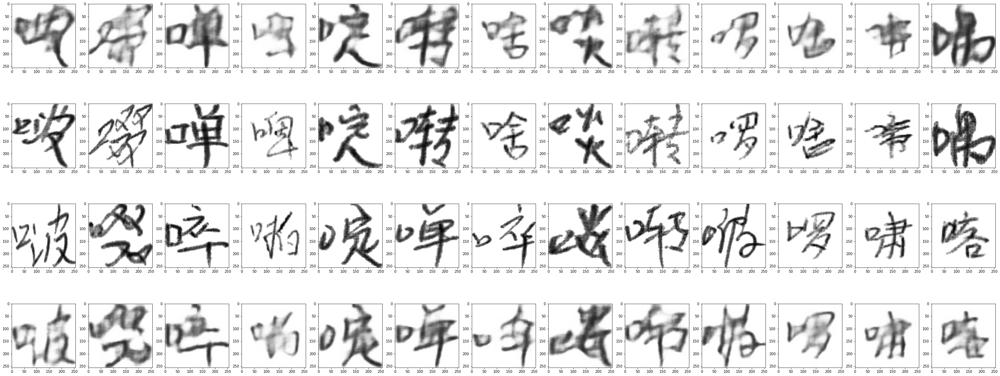

In this batch, we have 7 wrong predictions
True labels:  [0, 0, 1, 0, 0, 0, 1]


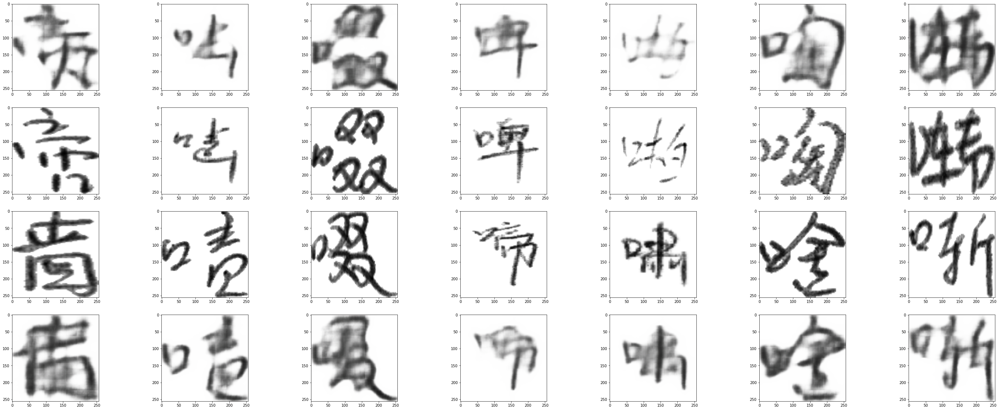

In this batch, we have 7 wrong predictions
True labels:  [0, 1, 1, 0, 0, 0, 0]


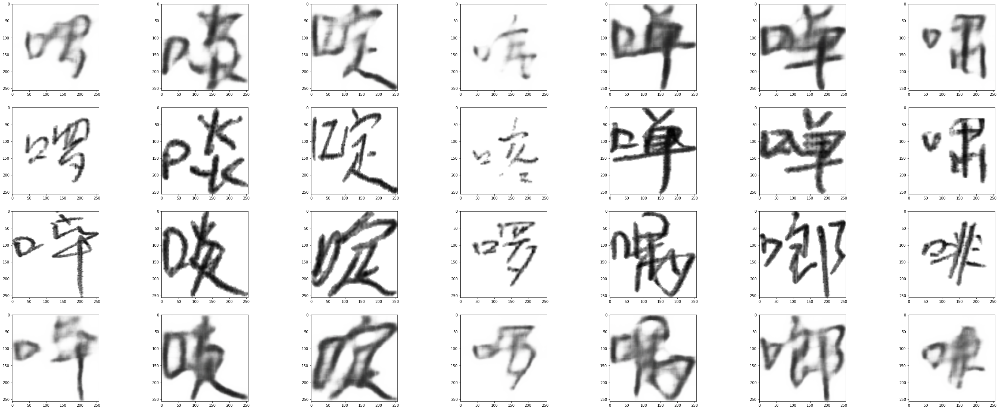

In this batch, we have 10 wrong predictions
True labels:  [1, 0, 0, 0, 0, 1, 0, 0, 0, 0]


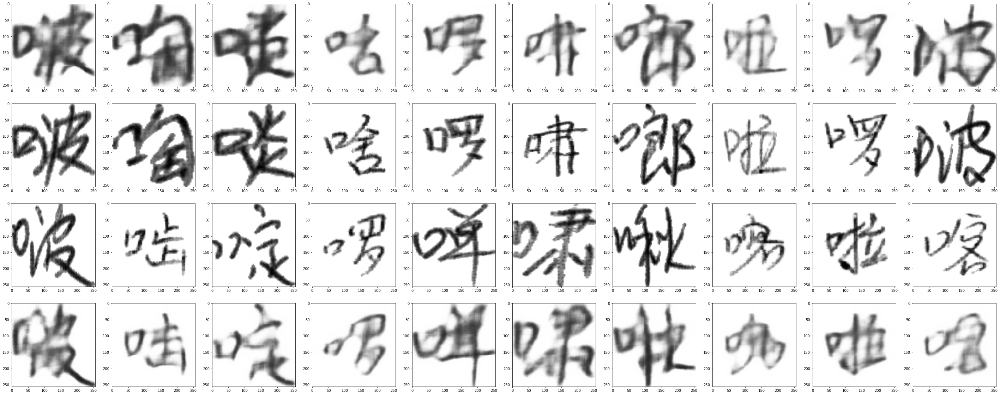

In this batch, we have 10 wrong predictions
True labels:  [0, 0, 0, 0, 1, 1, 0, 0, 1, 0]


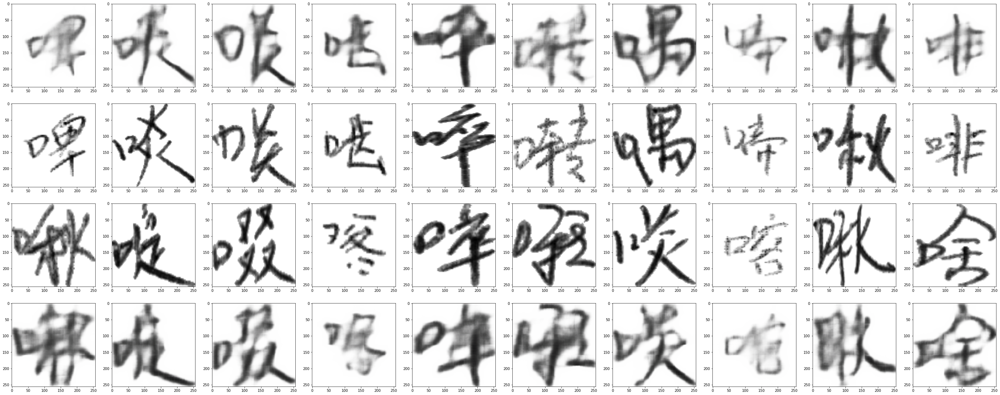

In this batch, we have 9 wrong predictions
True labels:  [0, 1, 1, 0, 0, 0, 1, 0, 1]


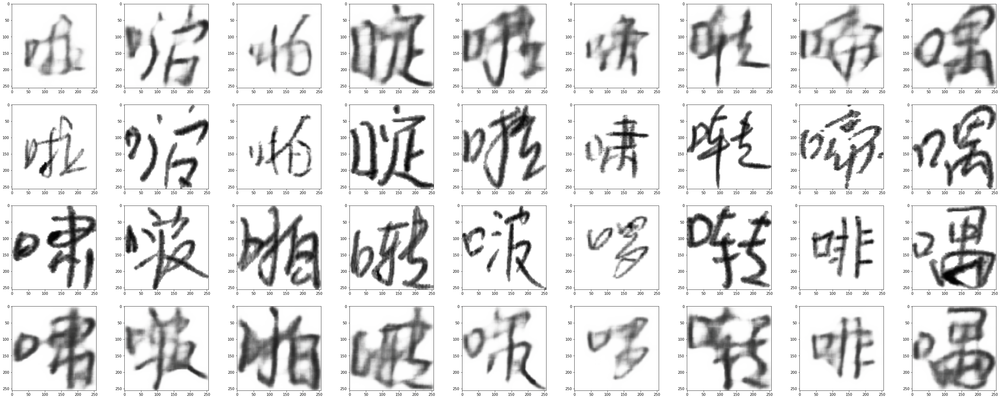

In this batch, we have 8 wrong predictions
True labels:  [0, 0, 0, 0, 0, 0, 0, 0]


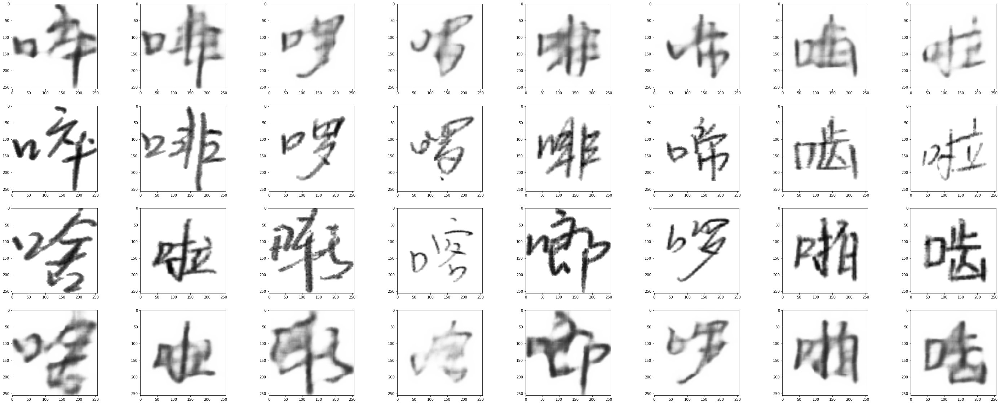

In this batch, we have 9 wrong predictions
True labels:  [0, 0, 0, 1, 1, 1, 1, 0, 0]


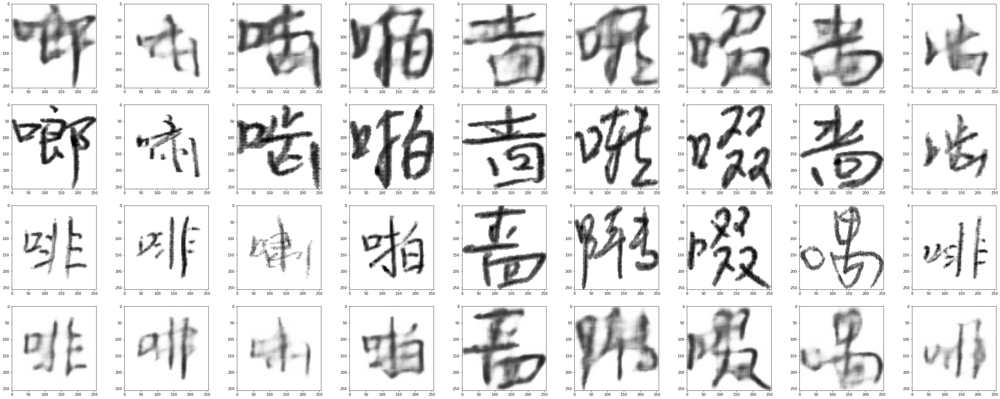

In this batch, we have 6 wrong predictions
True labels:  [1, 1, 0, 0, 0, 0]


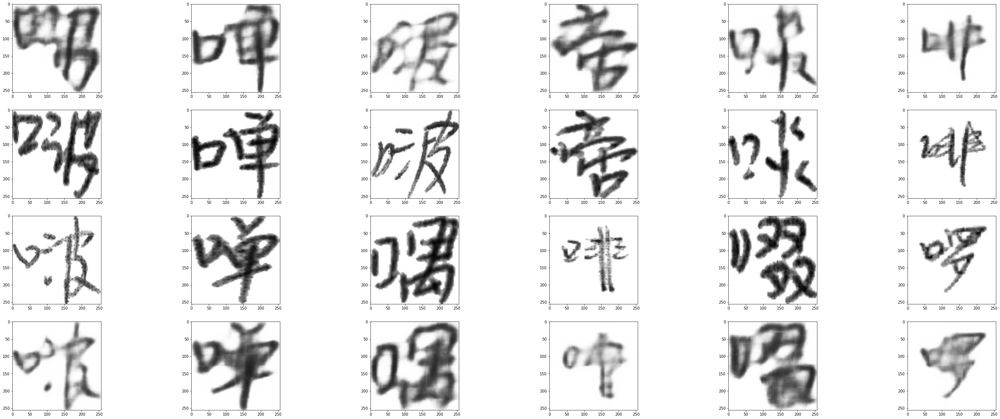

In this batch, we have 9 wrong predictions
True labels:  [1, 1, 0, 1, 0, 1, 0, 0, 0]


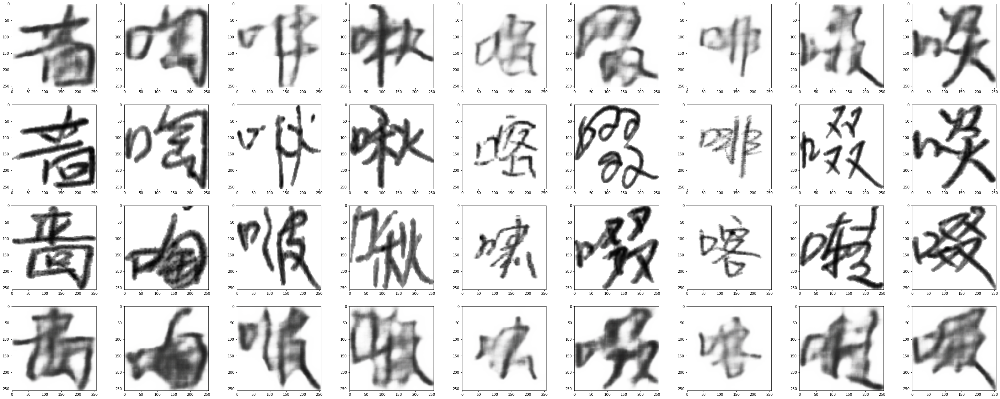

In this batch, we have 14 wrong predictions
True labels:  [1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0]


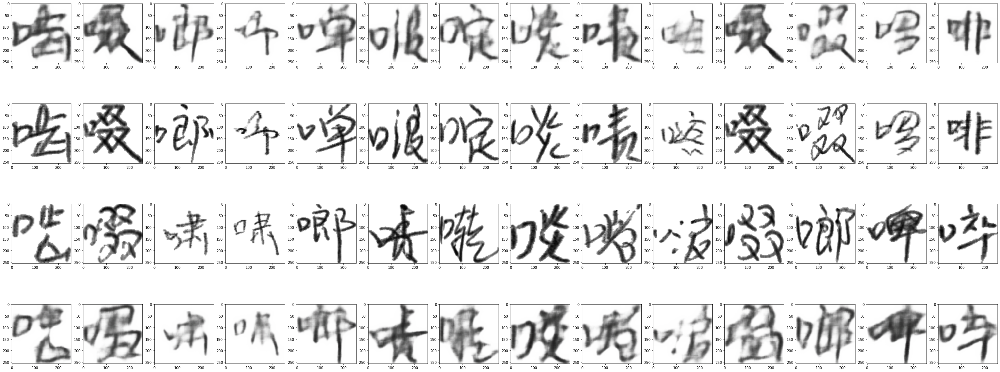

In this batch, we have 11 wrong predictions
True labels:  [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1]


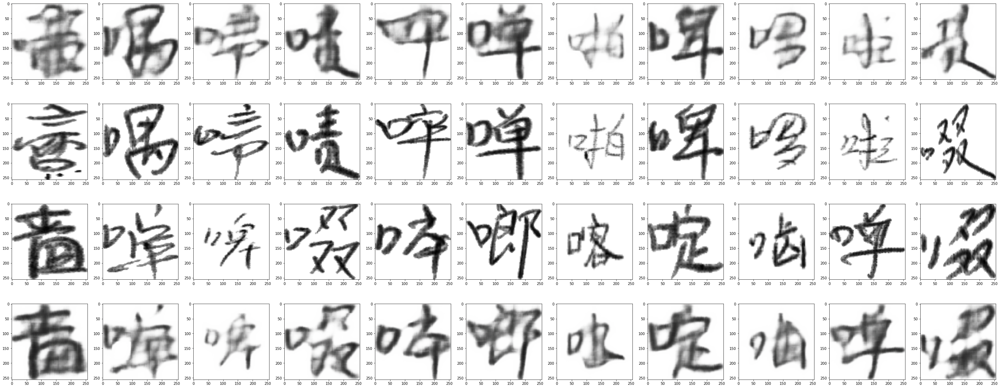

In [43]:
limit = 10
ctr = 0
for itr, (test_x, test_y) in enumerate(gen):
    tx1, tx2 = test_x
    x_logit1, z1, mean1, logvar1, x_logit2, z2, mean2, logvar2, zdots = model_vae_siamese([tx1, tx2])
    y_pred = dot([z1, z2])[:,0]
    
    predss = [int(x>0.5) for x in y_pred] 
    targtess = [int(x) for x in test_y]
    wrongs = [int(x!=y) for x,y in zip(predss, targtess)]
    print(f"In this batch, we have {sum(wrongs)} wrong predictions")
    if sum(wrongs) == 0:
        print("skipping batch")
        continue
    ctr += 1
    wrong_idxs = [i for i,val in enumerate(wrongs) if val==1]
    print("True labels: ", [test_y[x] for x in wrong_idxs])
    fig, ax = plt.subplots(4, len(wrong_idxs), figsize=(50, 20))
    for it, idx in enumerate(wrong_idxs):
        if sum(wrongs) > 1:
            xim1 = 1 / (1 + np.exp(-x_logit1[idx]))
            xim2 = 1 / (1 + np.exp(-x_logit2[idx]))
            ax[0, it].imshow(xim1)
            ax[1, it].imshow(test_x[0][idx])
            ax[2, it].imshow(test_x[1][idx])
            ax[3, it].imshow(xim2)
        else:
            xim1 = 1 / (1 + np.exp(-x_logit1[idx]))
            xim2 = 1 / (1 + np.exp(-x_logit2[idx]))
            ax[0].imshow(xim1)
            ax[1].imshow(test_x[0][idx])
            ax[2].imshow(test_x[1][idx])
            ax[3].imshow(xim2)
    plt.show()
        
    if itr > limit:
        break

In [11]:
conv_part2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (32, 127, 127, 32)        896       
_________________________________________________________________
conv2d_1 (Conv2D)            (32, 63, 63, 64)          18496     
_________________________________________________________________
conv2d_2 (Conv2D)            (32, 31, 31, 128)         73856     
_________________________________________________________________
conv2d_3 (Conv2D)            (32, 15, 15, 256)         295168    
_________________________________________________________________
conv2d_4 (Conv2D)            (32, 7, 7, 256)           590080    
_________________________________________________________________
flatten (Flatten)            (32, 12544)               0         
_________________________________________________________________
dense (Dense)                (32, 100)                 1

100%|██████████| 100/100 [01:45<00:00,  1.05s/it, Objective=13.8, Mean Objective=10.3]


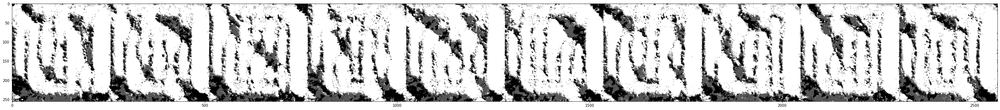

 14%|█▍        | 14/100 [00:15<01:35,  1.10s/it, Objective=5.65, Mean Objective=4.21]


KeyboardInterrupt: 

In [41]:
from mini_lucid_tf2 import objectives, render
layer_name = 'conv2d_4'
layer_size = 256

num_samples = 3
# 90

for j in range(num_samples):
#     chosen_indexes = random.choice(range(layer_size))
#     fig, ax = plt.subplots(1, num_rel_interp, figsize=(50, 50))
#     for itr in range(num_rel_interp):
#     rel_imp = [np.exp((random.random()-0.5)*sd_coef) for _ in range(layer_size)]
    obj = objectives.Channel(conv_part2, layer_name, j+21)#*rel_imp[chosen_indexes[0]] 
#     for i in chosen_indexes[1:]:
#         obj += objectives.Channel(conv_part2, layer_name, i)*rel_imp[i]
    image = render.render_vis(obj, 256, batch=batch_size, steps=(100,))
    fig = plt.figure(figsize=(50,5))
    plt.imshow(np.mean(np.concatenate([image[i] for i in range(10)], axis = -2), axis = -1), cmap='gray')
    plt.show()

In [16]:
random.choice([1,2])

2